In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestClassifier, VotingClassifier
from sklearn.feature_selection import SelectFromModel
from sklearn.metrics import classification_report, accuracy_score, confusion_matrix
from sklearn.model_selection import train_test_split, GridSearchCV, cross_val_score, KFold, learning_curve
from sklearn.svm import SVC
from sklearn.manifold import TSNE
from sklearn.model_selection import RandomizedSearchCV
from sklearn.svm import SVC
from scipy.stats import uniform, randint, loguniform 

In [2]:
# Load the dataset
data = pd.read_excel('C:/Users/jingj/Desktop/MASTER/Paper/Machine Learning/Feature Engineering/final_snp.xlsx')

In [3]:
data

,Row Header,Subspecies,SNP_OG0001278_motif_2,SNP_OG0001278_motif_3,SNP_OG0001278_motif_4,SNP_OG0001278_motif_5,SNP_OG0001279_motif_1,SNP_OG0001279_motif_3,SNP_OG0001281_motif_2,SNP_OG0001281_motif_3,...,SNP_OG0002828_motif_1,SNP_OG0002828_motif_2,SNP_OG0002828_motif_3,SNP_OG0002828_motif_4,SNP_OG0002828_motif_5,SNP_OG0002829_motif_1,SNP_OG0002829_motif_2,SNP_OG0002829_motif_3,SNP_OG0002829_motif_4,SNP_OG0002829_motif_5
0,Agona_1,0,24332,4433133,3144,33,222,22313422,1132324324,21331423,...,4141,3332,134434434,333413,231414311,3,34,3233,24,43142
1,Agona_10,0,24332,4433133,3144,33,222,22313422,1132324324,21331423,...,4141,3332,134434434,333413,231414311,3,34,3233,24,43142
2,Agona_11,0,24332,4433133,3144,33,222,22313422,1132324324,21331423,...,4141,3332,134434434,333413,231414311,3,34,3233,24,43142
3,Agona_12,0,24332,4433133,3144,33,222,22313422,1132324324,21331423,...,4141,3332,134434434,333413,231414311,3,34,3233,24,43142
4,Agona_13,0,24332,4433133,3144,33,222,22313422,1132324324,21331423,...,4141,3332,134434434,333413,231414311,3,34,3233,24,43142
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
253,salamae_5,16,24332,4423133,3141,23,222,22313422,1132321334,21234123,...,4141,3333,134434434,333413,221434311,3,34,3233,24,43142
254,salamae_6,16,24332,4423133,3144,33,222,22313424,1132321334,21234123,...,4141,3333,134434434,333413,321414311,3,34,2233,24,43142
255,salamae_7,16,24332,4423133,3144,33,222,22313422,1132321334,21234123,...,4141,3333,134434434,333413,221434311,3,34,3233,24,43142
256,salamae_8,16,24332,4423133,3144,33,222,22313422,1132321334,21234123,...,4141,3333,134434434,333413,221434311,3,34,3233,24,43142


In [4]:
# Exclude samples with Subspecies label "8"
# Label "8" is testing samples
data = data[(data['Subspecies'] != 8)]

# Select feature columns that start with 'SNP' at position 2
feature_names = [col for col in data.columns if col.startswith('SNP')]

In [5]:
data.shape

(240, 5256)

In [6]:
# Exclude 'Row Header' and 'Subspecies' columns from features
X = data.drop(['Row Header', 'Subspecies'], axis=1)
y = data['Subspecies']

In [7]:
X.shape

(240, 5254)

### Feature Scaling

In [8]:
# Data Scaling
scaler = StandardScaler()
X = scaler.fit_transform(X)

In [9]:
X

array([[ 0.1775667 ,  0.10613065, -0.01387124, ...,  0.1463759 ,
        -0.255041  ,  0.25908007],
       [ 0.1775667 ,  0.10613065, -0.01387124, ...,  0.1463759 ,
        -0.255041  ,  0.25908007],
       [ 0.1775667 ,  0.10613065, -0.01387124, ...,  0.1463759 ,
        -0.255041  ,  0.25908007],
       ...,
       [ 0.1775667 ,  0.03009296, -0.01387124, ...,  0.1463759 ,
        -0.255041  ,  0.25908007],
       [ 0.1775667 ,  0.03009296, -0.01387124, ...,  0.1463759 ,
        -0.255041  ,  0.25908007],
       [ 0.1775667 ,  0.03009296, -0.01387124, ...,  0.1463759 ,
        -0.255041  ,  0.25908007]])

### Feature Selection (Embedded Method)

In [10]:
# Parameters for feature selection  
n_runs = 100  # Number of times to run feature selection  
feature_selection_counts = pd.Series(0, index=range(X.shape[1]))  # Initialize counts for each feature  

In [11]:
# Run feature selection multiple times  
for run in range(n_runs):  
    # Split the data into training and testing sets  
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=run, stratify=y)  

    # Create and fit the Random Forest model  
    rf = RandomForestClassifier(random_state=run)  
    rf.fit(X_train, y_train)  

    # Create SelectFromModel with the fitted random forest model as the estimator  
    sfm = SelectFromModel(rf, prefit=True, threshold='mean')  # Use threshold='mean'  
    
    # Get the selected feature indices  
    selected_indices = sfm.get_support()  
    
    # Increment the count for selected features  
    feature_selection_counts += selected_indices  

In [12]:
# Convert counts to a DataFrame for better visualization  
selected_features_df = pd.DataFrame({  
    'Feature Index': feature_selection_counts.index,  
    'Selection Count': feature_selection_counts.values  
})  

In [13]:
selected_features_df

,Feature Index,Selection Count
0,0,26
1,1,24
2,2,4
3,3,0
4,4,39
...,...,...
5249,5249,0
5250,5250,24
5251,5251,0
5252,5252,1


In [14]:
# Sort by selection count  
selected_features_df = selected_features_df.sort_values(by='Selection Count', ascending=False)

In [15]:
# Display the most consistently selected features  
print("Most Consistently Selected Features:")  
print(selected_features_df)

Most Consistently Selected Features:
      Feature Index  Selection Count
2483           2483               99
134             134               97
4653           4653               96
1469           1469               96
128             128               95
...             ...              ...
1518           1518                0
2413           2413                0
3614           3614                0
2605           2605                0
697             697                0

[5254 rows x 2 columns]


In [16]:
# Set Pandas options to display all rows  
pd.set_option('display.max_rows', None)  # None means no limit on the number of rows displayed  

# Display the most consistently selected features  
print("Most Consistently Selected Features:")  
print(selected_features_df) 

Most Consistently Selected Features:
      Feature Index  Selection Count
2483           2483               99
134             134               97
4653           4653               96
1469           1469               96
128             128               95
4319           4319               95
4317           4317               95
4133           4133               94
5208           5208               94
4318           4318               93
4320           4320               93
1349           1349               93
2683           2683               93
3152           3152               93
2940           2940               93
3473           3473               93
2727           2727               92
4229           4229               92
3155           3155               92
548             548               91
3214           3214               91
209             209               91
2553           2553               91
4279           4279               91
2946           2946               91
4

In [17]:
# Optionally, map the feature indices to feature names if you have them  
selected_features_df['Feature Name'] = [feature_names[i] for i in selected_features_df['Feature Index']]  
print(selected_features_df[['Feature Name', 'Selection Count']])  

               Feature Name  Selection Count
2483  SNP_OG0001969_motif_3               99
134   SNP_OG0001324_motif_1               97
4653  SNP_OG0002646_motif_5               96
1469  SNP_OG0001679_motif_4               96
128   SNP_OG0001322_motif_4               95
4319  SNP_OG0002551_motif_3               95
4317  SNP_OG0002551_motif_1               95
4133  SNP_OG0002500_motif_5               94
5208  SNP_OG0002819_motif_3               94
4318  SNP_OG0002551_motif_2               93
4320  SNP_OG0002551_motif_5               93
1349  SNP_OG0001645_motif_3               93
2683  SNP_OG0002023_motif_1               93
3152  SNP_OG0002227_motif_4               93
2940  SNP_OG0002173_motif_4               93
3473  SNP_OG0002326_motif_3               93
2727  SNP_OG0002110_motif_4               92
4229  SNP_OG0002528_motif_2               92
3155  SNP_OG0002228_motif_5               92
548   SNP_OG0001434_motif_5               91
3214  SNP_OG0002247_motif_5               91
209   SNP_

In [18]:
# Select the top 20 features based on selection count  
top_20_features = selected_features_df.head(20)  

# Display the most consistently selected top 20 features  
print("Top 20 Most Consistently Selected Features:")  
print(top_20_features) 

Top 20 Most Consistently Selected Features:
      Feature Index  Selection Count           Feature Name
2483           2483               99  SNP_OG0001969_motif_3
134             134               97  SNP_OG0001324_motif_1
4653           4653               96  SNP_OG0002646_motif_5
1469           1469               96  SNP_OG0001679_motif_4
128             128               95  SNP_OG0001322_motif_4
4319           4319               95  SNP_OG0002551_motif_3
4317           4317               95  SNP_OG0002551_motif_1
4133           4133               94  SNP_OG0002500_motif_5
5208           5208               94  SNP_OG0002819_motif_3
4318           4318               93  SNP_OG0002551_motif_2
4320           4320               93  SNP_OG0002551_motif_5
1349           1349               93  SNP_OG0001645_motif_3
2683           2683               93  SNP_OG0002023_motif_1
3152           3152               93  SNP_OG0002227_motif_4
2940           2940               93  SNP_OG0002173_moti

In [19]:
# Set Pandas options to display all rows  
pd.set_option('display.max_rows', None)  # None means no limit on the number of rows displayed  

# Display the most consistently selected features  
print("Top 20 Most Consistently Selected Features:")  
print(top_20_features)  

Top 20 Most Consistently Selected Features:
      Feature Index  Selection Count           Feature Name
2483           2483               99  SNP_OG0001969_motif_3
134             134               97  SNP_OG0001324_motif_1
4653           4653               96  SNP_OG0002646_motif_5
1469           1469               96  SNP_OG0001679_motif_4
128             128               95  SNP_OG0001322_motif_4
4319           4319               95  SNP_OG0002551_motif_3
4317           4317               95  SNP_OG0002551_motif_1
4133           4133               94  SNP_OG0002500_motif_5
5208           5208               94  SNP_OG0002819_motif_3
4318           4318               93  SNP_OG0002551_motif_2
4320           4320               93  SNP_OG0002551_motif_5
1349           1349               93  SNP_OG0001645_motif_3
2683           2683               93  SNP_OG0002023_motif_1
3152           3152               93  SNP_OG0002227_motif_4
2940           2940               93  SNP_OG0002173_moti

In [20]:
# Plotting the top 20 feature importances  
plt.figure(figsize=(12, 20), dpi=1000)    
plt.barh(top_20_features['Feature Name'], top_20_features['Selection Count'], color='skyblue')  
plt.xlabel('Selection Count')  
plt.title('Top 20 Most Consistently Selected Features - Embedded Method')  
plt.gca().invert_yaxis()  # Invert y-axis to have the most selected feature on top  

# Save the figure as a high-resolution image  
plt.savefig('top_20_feature_importances_embedded.png', bbox_inches='tight', dpi=1000)  # Save as PNG with high dpi  
plt.show()  

In [21]:
# Export selected feature names to a text file  
with open("Embedded_selected_features_top20.txt", "w") as file:  
    for feature_name in top_20_features['Feature Name']:  
        file.write(feature_name + "\n")  

print("Selected feature names exported to Embedded_selected_features_top20.txt file.")

Selected feature names exported to Embedded_selected_features_top20.txt file.


In [22]:
# Prepare data for the selected top 20 features using the original X DataFrame  
top_20_feature_indices = top_20_features['Feature Index'].values  
top_20_data = pd.DataFrame(X, columns=feature_names).iloc[:, top_20_feature_indices]  

# Add the target variable (Subspecies) to the DataFrame  
top_20_data['Subspecies'] = y.reset_index(drop=True)  

# Rearrange columns to place 'Subspecies' as the first column  
top_20_data = top_20_data[['Subspecies'] + [col for col in top_20_data.columns if col != 'Subspecies']]  

# Export to Excel file  
top_20_data.to_excel("Embedded_selected_features_top20.xlsx", index=False)  

print("Selected features and their data exported to Embedded_selected_features_top20.xlsx file.")

Selected features and their data exported to Embedded_selected_features_top20.xlsx file.


In [23]:
# Extract the features (excluding the 'Subspecies' column)  
X_selected = top_20_data.drop(columns=['Subspecies'])  

# Extract the target variable  
y_selected = top_20_data['Subspecies']  

In [24]:
X_selected

,SNP_OG0001969_motif_3,SNP_OG0001324_motif_1,SNP_OG0002646_motif_5,SNP_OG0001679_motif_4,SNP_OG0001322_motif_4,SNP_OG0002551_motif_3,SNP_OG0002551_motif_1,SNP_OG0002500_motif_5,SNP_OG0002819_motif_3,SNP_OG0002551_motif_2,SNP_OG0002551_motif_5,SNP_OG0001645_motif_3,SNP_OG0002023_motif_1,SNP_OG0002227_motif_4,SNP_OG0002173_motif_4,SNP_OG0002326_motif_3,SNP_OG0002110_motif_4,SNP_OG0002528_motif_2,SNP_OG0002228_motif_5,SNP_OG0001434_motif_5
0,0.497787,0.080542,0.371667,-0.093707,0.000000,-0.747289,0.747289,0.178005,0.316551,-0.747289,0.747289,-0.373802,0.479146,0.468004,-0.121530,0.362920,0.106232,-0.375235,-0.291837,0.875283
1,0.497787,0.080542,0.371667,-0.093707,0.000000,1.338170,-1.338170,0.178005,0.316551,1.338170,-1.338170,-0.373802,0.479146,0.468004,-0.121530,0.362920,0.106232,-0.375235,-0.291837,0.875283
2,0.497787,0.080542,0.371667,-0.093707,0.000000,1.338170,-1.338170,0.178005,0.316551,1.338170,-1.338170,-0.373802,0.479146,0.468004,-0.121530,0.362920,0.106232,-0.375235,-0.291837,0.875283
3,0.497787,0.080542,0.371667,-0.093707,0.000000,-0.747289,0.747289,0.178005,0.316551,-0.747289,0.747289,-0.373802,0.479146,0.468004,-0.121530,0.362920,0.106232,-0.375235,-0.291837,0.875283
4,0.497787,0.080542,0.371667,-0.093707,0.000000,-0.747289,0.747289,0.178005,0.316551,-0.747289,0.747289,-0.373802,0.479146,0.468004,-0.121530,0.362920,0.106232,-0.375235,-0.291837,0.875283
5,0.497787,0.080542,0.371667,-0.093707,0.000000,1.338170,-1.338170,0.178005,0.316551,1.338170,-1.338170,-0.373802,0.479146,0.468004,-0.121530,0.362920,0.106232,-0.375235,-0.291837,0.875283
6,0.497787,0.080542,0.371667,-0.093707,0.000000,-0.747289,0.747289,0.178005,0.316551,-0.747289,0.747289,-0.373802,0.479146,0.468004,-0.121530,0.362920,0.106232,-0.375235,-0.291837,0.875283
7,0.497787,0.080542,0.371667,-0.093707,0.000000,-0.747289,0.747289,0.178005,0.316551,-0.747289,0.747289,-0.373802,0.479146,0.468004,-0.121530,0.362920,0.106232,-0.375235,-0.291837,0.875283
8,0.497787,0.080542,0.371667,-0.093707,0.000000,-0.747289,0.747289,0.178005,0.316551,-0.747289,0.747289,-0.373802,0.479146,0.468004,-0.121530,0.362920,0.106232,-0.375235,-0.291837,0.875283
9,0.497787,0.080542,0.371667,-0.093707,0.000000,1.338170,-1.338170,0.178005,0.316551,1.338170,-1.338170,-0.373802,0.479146,0.468004,-0.121530,0.362920,0.106232,-0.375235,-0.291837,0.875283


In [25]:
X_selected.shape

(240, 20)

In [26]:
# Calculate the correlation matrix  
correlation_matrix = top_20_data.corr()  

plt.figure(figsize=(15, 15), dpi=1000)  # Adjusting figure size  
mask = np.triu(np.ones_like(correlation_matrix, dtype=bool))  # Mask for upper triangle  
sns.heatmap(correlation_matrix, mask=mask, annot=False, cmap='coolwarm',   
            square=True, cbar_kws={"shrink": .8})  # Set annot=False to remove numbers  
plt.title('Correlation Matrix of Selected Features and Subspecies')  
plt.savefig('correlation_matrix.png', bbox_inches='tight', dpi=1000)  # Save the figure  
plt.show()  

### Train Test Split

In [27]:
# Split the selected features into training and testing sets  
X_train_selected, X_test_selected, y_train_selected, y_test_selected = train_test_split(  
    X_selected, y_selected, test_size=0.2, random_state=42, stratify=y_selected  
)  

print("Training and testing sets created for the selected top 20 features.")  

Training and testing sets created for the selected top 20 features.


In [28]:
X_train_selected

,SNP_OG0001969_motif_3,SNP_OG0001324_motif_1,SNP_OG0002646_motif_5,SNP_OG0001679_motif_4,SNP_OG0001322_motif_4,SNP_OG0002551_motif_3,SNP_OG0002551_motif_1,SNP_OG0002500_motif_5,SNP_OG0002819_motif_3,SNP_OG0002551_motif_2,SNP_OG0002551_motif_5,SNP_OG0001645_motif_3,SNP_OG0002023_motif_1,SNP_OG0002227_motif_4,SNP_OG0002173_motif_4,SNP_OG0002326_motif_3,SNP_OG0002110_motif_4,SNP_OG0002528_motif_2,SNP_OG0002228_motif_5,SNP_OG0001434_motif_5
5,0.497787,0.080542,0.371667,-0.093707,0.000000,1.338170,-1.338170,0.178005,0.316551,1.338170,-1.338170,-0.373802,0.479146,0.468004,-0.121530,0.362920,0.106232,-0.375235,-0.291837,0.875283
46,0.497787,0.080542,0.371667,-0.093707,0.000000,1.338170,-1.338170,0.178005,0.316551,1.338170,-1.338170,-0.373802,-1.996251,-1.600554,-0.121530,0.226480,0.106232,-0.375235,-0.291837,-1.207204
206,0.497787,0.080542,0.371667,-0.093707,0.000000,-0.747289,0.747289,0.178005,0.316551,-0.747289,0.747289,-0.373802,0.479146,0.452765,-0.122075,-3.866970,0.106232,-0.375114,-0.291837,0.875283
50,0.497787,0.080542,0.371667,-0.093707,0.000000,1.338170,-1.338170,0.178005,0.316551,1.338170,-1.338170,-0.373802,-1.996251,-1.600554,-0.121530,0.226480,0.106232,-0.375235,-0.291837,-1.207204
60,0.497787,0.346627,0.371667,-0.093707,0.000000,1.338170,-1.338170,-0.705576,0.316551,1.338170,-1.338170,-0.383545,0.479146,0.468004,-0.121531,0.226480,0.106232,-0.375235,-0.304176,-1.207204
229,0.506372,0.080542,0.167080,-0.093707,0.000000,-0.747289,0.747289,0.178005,0.316551,-0.747289,0.747289,2.549064,0.479146,-6.427256,-0.066966,0.362647,0.115088,-0.375114,-0.291837,-1.213471
189,-2.077622,0.346627,0.371667,-0.093707,0.000000,-0.747289,0.747289,0.178005,0.316551,-0.747289,0.747289,-0.373802,0.479146,-1.600554,-0.121524,0.226480,-8.749533,-0.375235,-0.291837,-1.207204
30,0.497787,0.080542,0.371667,-0.093707,-0.525226,1.338170,-1.338170,0.186840,-0.895707,1.338170,-1.338170,-0.373802,0.479146,0.468004,-0.121530,0.226480,0.194790,-0.375233,-0.291837,0.875283
140,0.497787,0.080542,0.371667,-0.093707,0.000000,-0.747289,0.747289,0.178005,0.316551,-0.747289,0.747289,-0.373802,-1.996251,0.468004,-0.121530,0.362647,0.106232,-0.375235,-0.291837,0.881549
194,0.497787,0.080542,0.371667,-0.093707,0.000000,1.338170,-1.338170,0.178005,0.316551,1.338170,-1.338170,-0.373802,0.479146,0.468004,-0.137899,0.226480,0.106232,-0.375235,-0.291837,0.881549


In [29]:
X_train_selected.shape

(192, 20)

In [81]:
# Create a dictionary mapping numbers to serovar names with numbers included  
serovar_names = {  
    0: '0 - serovar Agona',  
    1: '1 - serovar Dublin',  
    2: '2 - serovar Enteritidis',  
    3: '3 - serovar Heidelberg',  
    4: '4 - serovar Infantis',  
    5: '5 - serovar Montevideo',  
    6: '6 - serovar Newport',  
    7: '7 - serovar Schwarzengrund',  
    9: '9 - serovar Typhi',  
    10: '10 - serovar Typhimurium',  
    11: '11 - subspecies arizonae',  
    12: '12 - subspecies diarizonae',  
    13: '13 - subspecies enterica',  
    14: '14 - subspecies houtenae',  
    15: '15 - subspecies indica',  
    16: '16 - subspecies salamae'  
}   

# Apply t-SNE to the selected features for visualization  
tsne = TSNE(n_components=2, random_state=42)  
X_train_tsne = tsne.fit_transform(X_train_selected)  

# Create a DataFrame for plotting  
tsne_df = pd.DataFrame(X_train_tsne, columns=['Dim1', 'Dim2'])  
tsne_df['Subspecies_num'] = y_train_selected.values  # Keep numeric values  
tsne_df['Subspecies'] = tsne_df['Subspecies_num'].map(serovar_names)  

# Define highly contrasting colors  
distinct_colors = [  
    '#E6194B',     # Red  
    '#3CB44B',     # Green  
    '#4363D8',     # Blue  
    '#911EB4',     # Purple  
    '#F58231',     # Orange  
    '#FFE119',     # Yellow  
    '#00008B',     # Dark Blue  
    '#F032E6',     # Magenta  
    '#800000',     # Maroon  
    '#008080',     # Teal  
    '#E6BEFF',     # Lavender  
    '#C0C0C0',     # Silver 
    '#FFB6C1',     # Light Pink   
    '#808000',     # Olive  
    '#aaffc3',     # Light Green
    '#42D4F4'      # Cyan 
]  
 

# Set the style for better visibility  
plt.style.use('default')  
plt.figure(figsize=(15, 10), dpi=1000)  

# Create scatter plot with some transparency  
sns.scatterplot(  
    x='Dim1',   
    y='Dim2',   
    hue='Subspecies',   
    palette=distinct_colors[:len(tsne_df['Subspecies'].unique())],  
    data=tsne_df,   
    s=50,  
    alpha=0.7,  # Add some transparency  
    hue_order=[serovar_names[i] for i in sorted(serovar_names.keys())]  # Order legend by original numbers  
)  

plt.title('t-SNE Visualization of the Subspecies and Serovar Clusters', pad=20, fontsize=14, fontweight='bold')  
plt.xlabel('Dimension 1', fontsize=12)  
plt.ylabel('Dimension 2', fontsize=12)  

# Adjust legend  
plt.legend(  
    title='Subspecies and Serovars',   
    bbox_to_anchor=(1.05, 1),   
    loc='upper left',  
    borderaxespad=0,  
    frameon=True,  
    shadow=True,  
    fancybox=True,  
    fontsize=10,  
    title_fontsize=12  
)   

# Adjust layout to prevent legend cutoff  
plt.tight_layout()  

# Save the figure as a high-resolution image  
plt.savefig('tsne_visualization_subspecies.png', bbox_inches='tight', dpi=1000)  
plt.show()

### Training the Model (Random Forest)

In [43]:
# Train the model using the selected features
model = RandomForestClassifier()
model.fit(X_train_selected, y_train_selected)

# Make predictions
predictions = model.predict(X_test_selected)

# Evaluate the model
accuracy = accuracy_score(y_test_selected, predictions)
print(f"Accuracy: {accuracy}")

# Create a DataFrame with predicted and actual labels
results_df = pd.DataFrame({'Predicted': predictions, 'Actual': y_test_selected})

# Display the predictions and actual labels
print(results_df)

# View detailed classification report
print(classification_report(y_test_selected, predictions))

Accuracy: 0.9791666666666666
     Predicted  Actual
171         12      12
154         11      11
190         13      13
6            0       0
179         12      12
49           3       3
204         14      14
124          9       9
35          10       2
130          9       9
120          9       9
201         14      14
232         16      16
233         16      16
63           4       4
165         12      12
3            0       0
216         15      15
102          6       6
12           0       0
51           3       3
41           2       2
94           6       6
186         13      13
105          7       7
149         10      10
117          7       7
89           5       5
91           6       6
53           3       3
142         10      10
80           5       5
71           4       4
84           5       5
141         10      10
150         11      11
212         15      15
17           1       1
29           1       1
39           2       2
152         11      11
182  

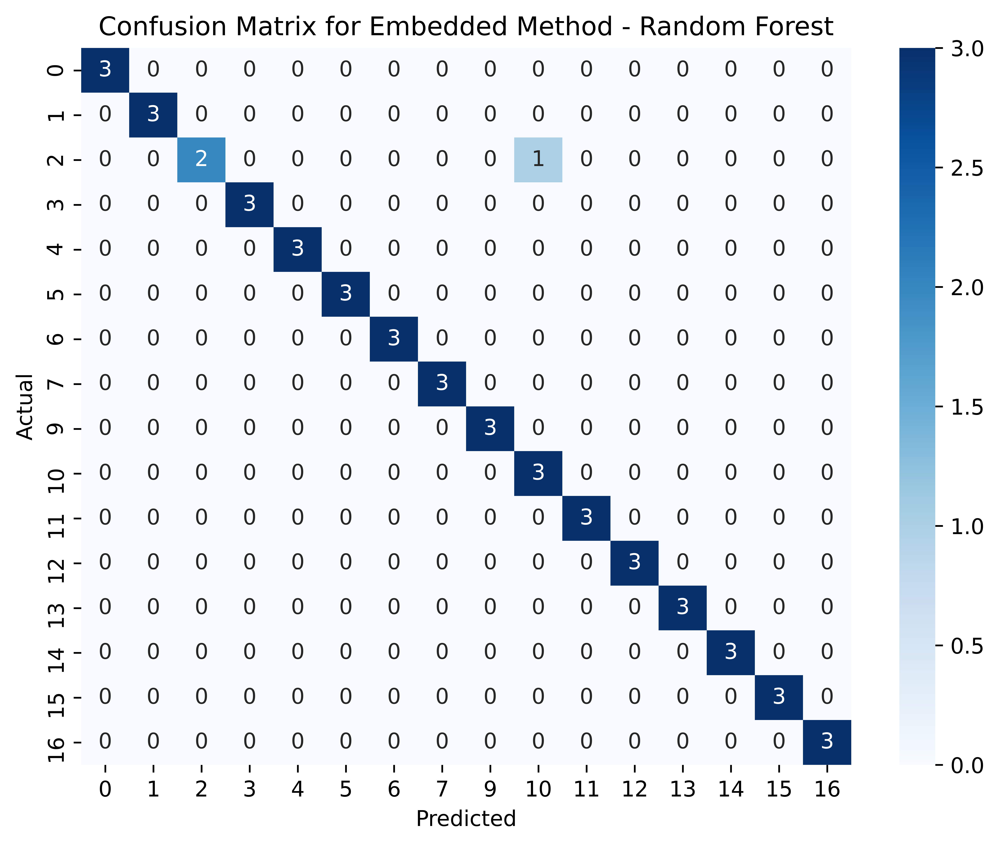

In [44]:
# Get predictions from your model  
y_pred = model.predict(X_test_selected)  

# Compute confusion matrix  
cm = confusion_matrix(y_test_selected, y_pred)  

# Plot confusion matrix using seaborn heatmap  
plt.figure(figsize=(8, 6), dpi=1000)  # Set the figure size and dpi for high resolution  
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',   
            xticklabels=np.unique(y_test_selected),   
            yticklabels=np.unique(y_test_selected))  
plt.xlabel('Predicted')  
plt.ylabel('Actual')  
plt.title('Confusion Matrix for Embedded Method - Random Forest')  # Updated title  

# Save the figure as a high-resolution image before showing it  
plt.savefig('confusion_matrix_random_forest.png', bbox_inches='tight', dpi=1000)  # Save as PNG with high dpi  

# Show the plot  
plt.show()  

In [45]:
# Perform K-Fold Cross-Validation with 10 folds using the selected features  
kfold = KFold(n_splits=10, shuffle=True, random_state=42)  
cv_scores = cross_val_score(RandomForestClassifier(random_state=42), X_train_selected, y_train_selected, cv=kfold, scoring='accuracy')  

# Print the cross-validation scores  
print("Cross-Validation Scores:", cv_scores)  
print("Mean Accuracy: {:.2f}".format(cv_scores.mean()))

Cross-Validation Scores: [0.9        1.         1.         0.94736842 0.94736842 1.
 0.94736842 0.94736842 0.94736842 0.94736842]
Mean Accuracy: 0.96


In [46]:
train_sizes, train_scores, test_scores = learning_curve(  
    model,   
    X,  # Use the original dataset  
    y,   
    train_sizes=np.linspace(0.1, 1.0, 10),   
    cv=5  
)  

# Plot the learning curve  
plt.figure(figsize=(12, 8), dpi=1000)  # Set the figure size and dpi for high resolution  
plt.plot(train_sizes, np.mean(train_scores, axis=1), label='Training score')  
plt.plot(train_sizes, np.mean(test_scores, axis=1), label='Cross-validation score')  
plt.xlabel('Training examples')  
plt.ylabel('Score')  
plt.title('Learning Curve of Embedded Method - Random Forest (Original Dataset)')  # Updated title  
plt.legend()  

# Save the figure as a high-resolution image  
plt.savefig('learning_curve_random_forest.png', bbox_inches='tight', dpi=1000)  # Save as PNG with high dpi  

# Show the plot  
plt.show()  

In [47]:
train_sizes, train_scores, test_scores = learning_curve(  
    model,   
    X_train_selected,  # Use the selected features  
    y_train_selected,   
    train_sizes=np.linspace(0.1, 1.0, 10),   
    cv=5  
)  

# Plot the learning curve  
plt.figure(figsize=(12, 8), dpi=1000)  # Set the figure size and dpi for high resolution  
plt.plot(train_sizes, np.mean(train_scores, axis=1), label='Training score')  
plt.plot(train_sizes, np.mean(test_scores, axis=1), label='Cross-validation score')  
plt.xlabel('Training examples')  
plt.ylabel('Score')  
plt.title('Learning Curve of Embedded Method - Random Forest (Top 20 Features Dataset)')  # Updated title  
plt.legend()  

# Save the figure as a high-resolution image  
plt.savefig('learning_curve_random_forest_top_20_features.png', bbox_inches='tight', dpi=1000)  # Save as PNG with high dpi  

# Show the plot  
plt.show()

### Hyperparameter Tuning (Random Forest)

In [48]:
# Initialize Random Forest Classifier  
rf2 = RandomForestClassifier(random_state=42)  

# Define the hyperparameter grid to search through  
param_grid = {  
    'n_estimators': [50, 100, 200, 400],  
    'max_depth': [10, 20, 30, 40, 50, None],  
    'min_samples_split': [2, 5, 10, 15],  
    'min_samples_leaf': [1, 2, 4, 6],  
    'max_features': ['sqrt', 'log2', None],
    'criterion': ['gini', 'entropy', 'log_loss']
}  

# Initialize Grid Search Cross-Validation  
grid_search = GridSearchCV(estimator=rf2, param_grid=param_grid, cv=5, scoring='accuracy')  

# Fit Grid Search on the training data  
grid_search.fit(X_train_selected, y_train_selected)  

# Retrieve the best model and parameters  
best_rf = grid_search.best_estimator_  
best_params = grid_search.best_params_  

# Evaluate the best model on the test set  
y_pred_best = best_rf.predict(X_test_selected)  
accuracy_best = accuracy_score(y_test_selected, y_pred_best)  

print(f'Best Parameters: {best_params}')  
print(f'Accuracy with Best Model: {accuracy_best}') 

Best Parameters: {'criterion': 'gini', 'max_depth': 10, 'max_features': 'sqrt', 'min_samples_leaf': 1, 'min_samples_split': 5, 'n_estimators': 200}
Accuracy with Best Model: 0.9791666666666666


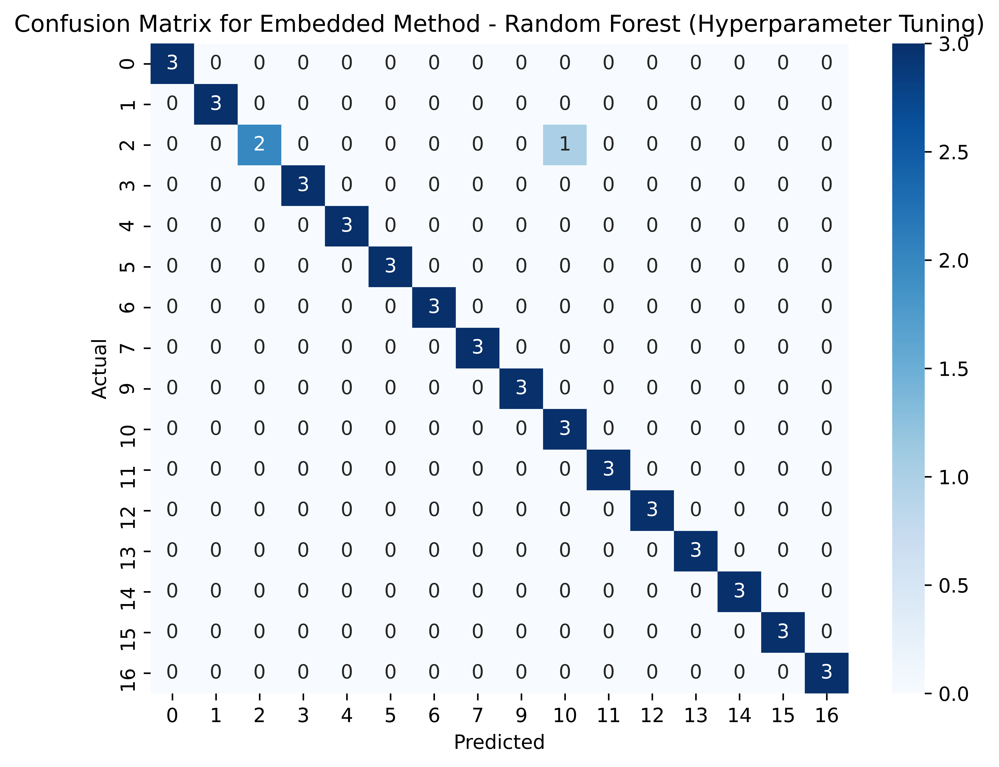

In [49]:
# Compute confusion matrix  
cm = confusion_matrix(y_test_selected, y_pred_best)  

# Plot confusion matrix using seaborn heatmap  
plt.figure(figsize=(8, 6), dpi=1000)  # Set the figure size and dpi for high resolution  
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',   
            xticklabels=np.unique(y_test_selected),   
            yticklabels=np.unique(y_test_selected))  
plt.xlabel('Predicted')  
plt.ylabel('Actual')  
plt.title('Confusion Matrix for Embedded Method - Random Forest (Hyperparameter Tuning)')  # Updated title  

# Save the figure as a high-resolution image before showing it  
plt.savefig('confusion_matrix_random_forest_hyperparameter_tuning.png', bbox_inches='tight', dpi=1000)  # Save as PNG with high dpi  

# Show the plot  
plt.show() 

In [50]:
# Define the best Random Forest model with the best parameters  
best_rf_cv = RandomForestClassifier(**best_params)  

# Perform cross-validation with 10 folds  
cv_scores = cross_val_score(best_rf_cv, X_train_selected, y_train_selected, cv=10, scoring='accuracy')  

# Print the cross-validation scores  
print("Cross-Validation Scores:")  
for fold, score in enumerate(cv_scores, 1):  
    print(f"Fold {fold}: {score}")  

# Calculate the mean and standard deviation of the cross-validation scores  
mean_cv_score = cv_scores.mean()  
std_cv_score = cv_scores.std()  

print(f"\nMean Cross-Validation Score: {mean_cv_score}")  
print(f"Standard Deviation of Cross-Validation Scores: {std_cv_score}")

Cross-Validation Scores:
Fold 1: 0.95
Fold 2: 1.0
Fold 3: 0.9473684210526315
Fold 4: 1.0
Fold 5: 0.9473684210526315
Fold 6: 0.9473684210526315
Fold 7: 0.8947368421052632
Fold 8: 0.9473684210526315
Fold 9: 0.9473684210526315
Fold 10: 1.0

Mean Cross-Validation Score: 0.9581578947368421
Standard Deviation of Cross-Validation Scores: 0.03150100029190474


In [51]:
# Generate learning curves with varying training set sizes  
train_sizes, train_scores, valid_scores = learning_curve(  
    best_rf_cv,   
    X_train_selected,   
    y_train_selected,   
    train_sizes=np.linspace(0.1, 1.0, 10),   
    cv=5  
)  

# Calculate mean training and validation scores across folds  
train_scores_mean = np.mean(train_scores, axis=1)  
valid_scores_mean = np.mean(valid_scores, axis=1)  

# Plot the learning curve  
plt.figure(figsize=(12, 8), dpi=1000)  # Set the figure size and dpi for high resolution  
plt.plot(train_sizes, train_scores_mean, label='Training Score', marker='o')  
plt.plot(train_sizes, valid_scores_mean, label='Validation Score', marker='o')  
plt.xlabel('Training Set Size')  
plt.ylabel('Accuracy Score')  
plt.title('Learning Curve for Embedded Method - Random Forest (Hyperparameter Tuning)')  # Updated title  
plt.legend()  
plt.grid()  

# Save the figure as a high-resolution image  
plt.savefig('learning_curve_random_forest_hyperparameter_tuning.png', bbox_inches='tight', dpi=1000)  # Save as PNG with high dpi  

plt.show()  

In [53]:
# Generate the classification report
report = classification_report(y_test_selected, y_pred_best)  
print("Classification Report:")  
print(report)  

Classification Report:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00         3
           1       1.00      1.00      1.00         3
           2       1.00      0.67      0.80         3
           3       1.00      1.00      1.00         3
           4       1.00      1.00      1.00         3
           5       1.00      1.00      1.00         3
           6       1.00      1.00      1.00         3
           7       1.00      1.00      1.00         3
           9       1.00      1.00      1.00         3
          10       0.75      1.00      0.86         3
          11       1.00      1.00      1.00         3
          12       1.00      1.00      1.00         3
          13       1.00      1.00      1.00         3
          14       1.00      1.00      1.00         3
          15       1.00      1.00      1.00         3
          16       1.00      1.00      1.00         3

    accuracy                           0.98        48
   

In [54]:
# Identify misclassified samples
misclassified_indices = [i for i in range(len(y_test_selected)) if y_test_selected.iloc[i] != y_pred_best[i]]  

# Create a DataFrame to show the true and predicted labels of misclassified samples
misclassified_samples = pd.DataFrame({  
 'True Label': y_test_selected.iloc[misclassified_indices].values,  
 'Predicted Label': y_pred_best[misclassified_indices],  
 'Sample Index': misclassified_indices})  

# Print misclassified samplesprint("Misclassified Samples:")  
print(misclassified_samples)  

   True Label  Predicted Label  Sample Index
0           2               10             8


In [60]:
# Evaluate the model
accuracy = accuracy_score(y_test_selected, predictions)  
print(f"Accuracy: {accuracy}")  

# Create a DataFrame with predicted and actual labels, including row headers
results_df = pd.DataFrame({  
    'Row Header': y_test_selected.index, # Keeping the original index
    'Predicted': predictions, 
    'Actual': y_test_selected.reset_index(drop=True)})  

# Display the results DataFrame
print("Results DataFrame:")  
print(results_df)  

# Get the total number of samplesnum_samples = len(results_df)print(f'Number of samples: {num_samples}')# View detailed classification reportprint("Classification Report:")  
print(classification_report(y_test_selected, predictions)) 

Accuracy: 0.9791666666666666
Results DataFrame:
    Row Header  Predicted  Actual
0          171         12      12
1          154         11      11
2          190         13      13
3            6          0       0
4          179         12      12
5           49          3       3
6          204         14      14
7          124          9       9
8           35         10       2
9          130          9       9
10         120          9       9
11         201         14      14
12         232         16      16
13         233         16      16
14          63          4       4
15         165         12      12
16           3          0       0
17         216         15      15
18         102          6       6
19          12          0       0
20          51          3       3
21          41          2       2
22          94          6       6
23         186         13      13
24         105          7       7
25         149         10      10
26         117          7       7


#### Ranking of Feature Importance of Random Forest

In [61]:
# Retrieve feature importance from the best model  
feature_importances = best_rf.feature_importances_  

# Create a DataFrame for the feature importances  
importance_df = pd.DataFrame({  
    'Feature Name': top_20_features['Feature Name'],  
    'Importance': feature_importances  
})  

In [62]:
importance_df

,Feature Name,Importance
2483,SNP_OG0001969_motif_3,0.073534
134,SNP_OG0001324_motif_1,0.037204
4653,SNP_OG0002646_motif_5,0.024465
1469,SNP_OG0001679_motif_4,0.022049
128,SNP_OG0001322_motif_4,0.028396
4319,SNP_OG0002551_motif_3,0.005344
4317,SNP_OG0002551_motif_1,0.004291
4133,SNP_OG0002500_motif_5,0.048906
5208,SNP_OG0002819_motif_3,0.052682
4318,SNP_OG0002551_motif_2,0.004733


In [63]:
# Sort the DataFrame by importance  
importance_df = importance_df.sort_values(by='Importance', ascending=False)  

# Plotting the feature importances  
plt.figure(figsize=(12, 25), dpi=1000)  
plt.barh(importance_df['Feature Name'], importance_df['Importance'], color='skyblue')  
plt.xlabel('Importance Score')  
plt.title('Feature Importances from Embedded Method - Random Forest Model')  
plt.gca().invert_yaxis()  # Invert y-axis for better visualization  
plt.savefig('feature_importances_embedded_random_forest.png', bbox_inches='tight', dpi=1000)  
plt.show()  

In [64]:
# Save the feature importances to a CSV  
importance_df.to_csv('feature_importances_embedded_random forest.csv', index=False)  

### Training the Model (SVM)

In [65]:
# Initialize the SVM model  
svm_model = SVC()  
svm_model.fit(X_train_selected, y_train_selected)  # Fit the model on the training data  

# Make predictions  
svm_predictions = svm_model.predict(X_test_selected)  

# Evaluate the model  
svm_accuracy = accuracy_score(y_test_selected, svm_predictions)  
print(f"Accuracy: {svm_accuracy}")  

# Create a DataFrame with predicted and actual labels  
results_df_svm = pd.DataFrame({'Predicted': svm_predictions, 'Actual': y_test_selected})  # Create results DataFrame  

# Display the predictions and actual labels  
print(results_df_svm)  

# View detailed classification report  
print(classification_report(y_test_selected, svm_predictions))

Accuracy: 0.8541666666666666
     Predicted  Actual
171         12      12
154         11      11
190          0      13
6            0       0
179         12      12
49           3       3
204         14      14
124          9       9
35          10       2
130          9       9
120          9       9
201         14      14
232          0      16
233          0      16
63           4       4
165         12      12
3            0       0
216         15      15
102          6       6
12           0       0
51           3       3
41           2       2
94           6       6
186          0      13
105          7       7
149         10      10
117          7       7
89           5       5
91           6       6
53           3       3
142         10      10
80           5       5
71           4       4
84           5       5
141         10      10
150         11      11
212         15      15
17           1       1
29           1       1
39           2       2
152         11      11
182  

C:\Users\jingj\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\jingj\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\jingj\Anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


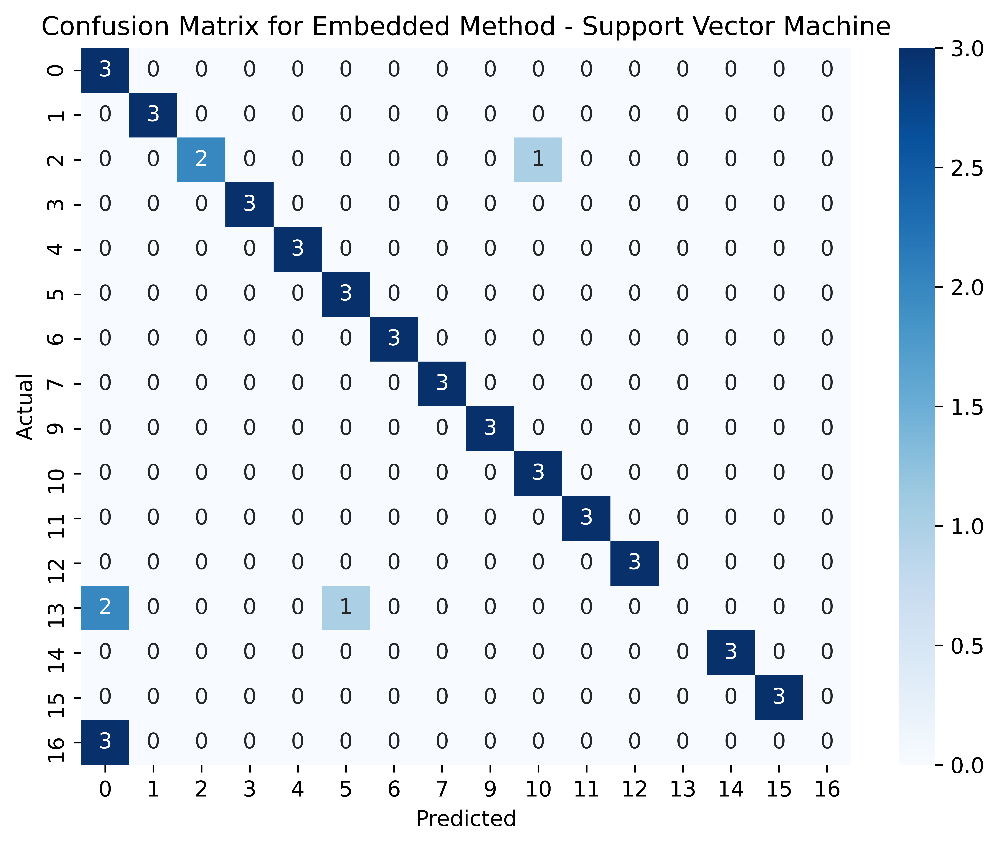

In [66]:
svm_predictions = svm_model.predict(X_test_selected)  # Use the SVM model's predictions  

# Compute confusion matrix  
cm = confusion_matrix(y_test_selected, svm_predictions)  

# Plot confusion matrix using seaborn heatmap  
plt.figure(figsize=(8, 6), dpi=1000)  # Set the figure size and dpi for high resolution  
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',   
            xticklabels=np.unique(y_test_selected),   
            yticklabels=np.unique(y_test_selected))  
plt.xlabel('Predicted')  
plt.ylabel('Actual')  
plt.title('Confusion Matrix for Embedded Method - Support Vector Machine')  # Updated title  

# Save the figure as a high-resolution image  
plt.savefig('confusion_matrix_svm.png', bbox_inches='tight', dpi=1000)  # Save as PNG with high dpi  

# Show the plot  
plt.show()  

In [67]:
# Initialize a new SVM model for cross-validation  
svm_model_cv = SVC()  

# Perform K-Fold Cross-Validation with 10 folds using the top 20 features  
kfold2 = KFold(n_splits=10, shuffle=True, random_state=42)  
cv_scores = cross_val_score(svm_model_cv, X_train_selected, y_train_selected, cv=kfold2, scoring='accuracy')  

# Print the cross-validation scores  
print("Cross-Validation Scores:", cv_scores)  
print("Mean Accuracy: {:.2f}".format(cv_scores.mean()))  

Cross-Validation Scores: [0.7        0.75       0.73684211 0.68421053 0.78947368 0.94736842
 0.78947368 0.84210526 0.73684211 0.78947368]
Mean Accuracy: 0.78


In [68]:
# Generate learning curves with varying training set sizes  
train_sizes, train_scores, test_scores = learning_curve(  
    svm_model,  # Use the SVM model  
    X,   
    y,   
    train_sizes=np.linspace(0.1, 1.0, 10),   
    cv=5  
)  

# Calculate mean training and validation scores across folds  
train_scores_mean = np.mean(train_scores, axis=1)  
test_scores_mean = np.mean(test_scores, axis=1)  

# Plot the learning curve  
plt.figure(figsize=(12, 8), dpi=1000)  # Set the figure size and dpi for high resolution  
plt.plot(train_sizes, train_scores_mean, label='Training Score', marker='o')  
plt.plot(train_sizes, test_scores_mean, label='Cross-validation Score', marker='o')  
plt.xlabel('Training Set Size')  
plt.ylabel('Score')  
plt.title('Learning Curve of Embedded Method - Support Vector Machine (Original Dataset)')  # Updated title  
plt.legend()  

# Save the figure as a high-resolution image  
plt.savefig('learning_curve_svm.png', bbox_inches='tight', dpi=1000)  # Save as PNG with high dpi  

# Show the plot  
plt.show()  

In [69]:
# Generate learning curves with varying training set sizes  
train_sizes, train_scores, test_scores = learning_curve(  
    svm_model,  # Use the SVM model  
    X_train_selected,  # Use the selected features  
    y_train_selected,   
    train_sizes=np.linspace(0.1, 1.0, 10),   
    cv=5  
)  

# Calculate mean training and validation scores across folds  
train_scores_mean = np.mean(train_scores, axis=1)  
test_scores_mean = np.mean(test_scores, axis=1)  

# Plot the learning curve  
plt.figure(figsize=(12, 8), dpi=1000)  # Set the figure size and dpi for high resolution  
plt.plot(train_sizes, train_scores_mean, label='Training Score', marker='o')  
plt.plot(train_sizes, test_scores_mean, label='Cross-validation Score', marker='o')  
plt.xlabel('Training Set Size')  
plt.ylabel('Score')  
plt.title('Learning Curve of Embedded Method - Support Vector Machine (Top 20 Features Dataset)')  # Updated title  
plt.legend()  

# Save the figure as a high-resolution image  
plt.savefig('learning_curve_SVM_top_20_features.png', bbox_inches='tight', dpi=1000)  # Save as PNG with high dpi  

# Show the plot  
plt.show()  

### Hyperparameter Tuning (SVM)

In [70]:
# Define the hyperparameter grid
param_grid = {  
    'C': loguniform(1e-3, 1e3),  # Regularization parameter on a logarithmic scale  
    'kernel': ['linear', 'poly', 'rbf', 'sigmoid'],  # Kernel type  
    'gamma': ['scale', 'auto'] + list(loguniform.rvs(1e-4, 1, size=5))  # Include random values for gamma  
}

# Initialize the RandomizedSearchCV object
svm = SVC()
random_search = RandomizedSearchCV(estimator=svm, param_distributions=param_grid, n_iter=20, scoring='accuracy', cv=5)

# Fit the RandomizedSearchCV object
random_search.fit(X_train_selected, y_train_selected)

# Retrieve the best model and parameters
best_svm = random_search.best_estimator_
best_params = random_search.best_params_

# Evaluate the best model on the test set
y_pred_best = best_svm.predict(X_test_selected)
accuracy_best = accuracy_score(y_test_selected, y_pred_best)

print(f'Best Parameters: {best_params}')
print(f'Accuracy with Best Model: {accuracy_best}')

Best Parameters: {'C': 389.84939014945274, 'gamma': 'auto', 'kernel': 'sigmoid'}
Accuracy with Best Model: 0.8541666666666666


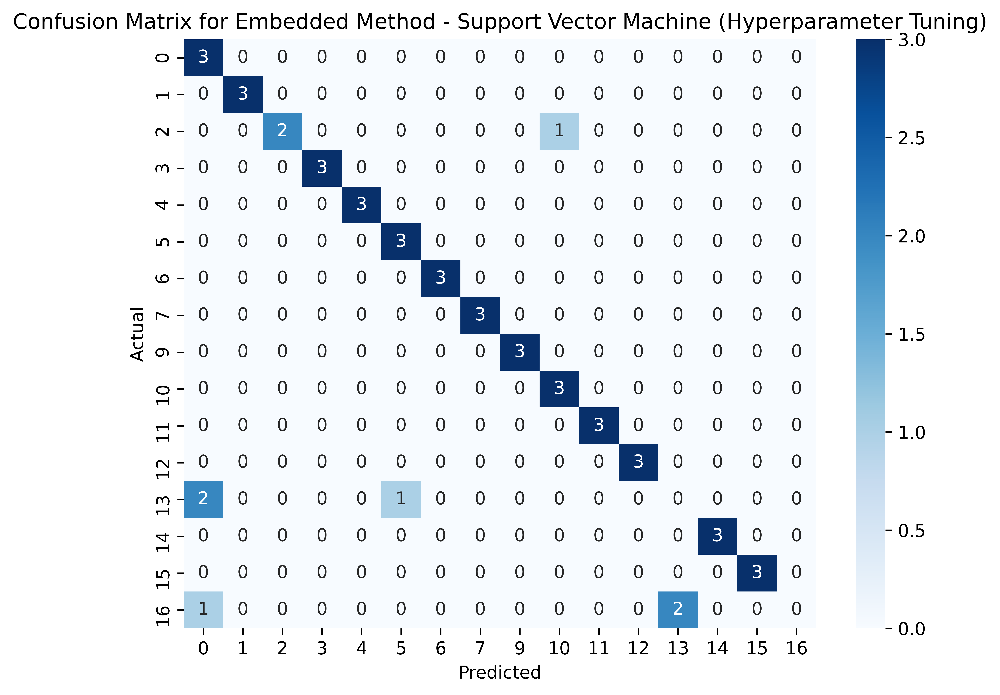

In [71]:
# Calculate the confusion matrix  
cm = confusion_matrix(y_test_selected, y_pred_best) 

# Plot confusion matrix using seaborn heatmap  
plt.figure(figsize=(8, 6), dpi=1000)  # Set the figure size and dpi for high resolution  
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',   
            xticklabels=np.unique(y_test_selected),   
            yticklabels=np.unique(y_test_selected))  
plt.xlabel('Predicted')  
plt.ylabel('Actual')  
plt.title('Confusion Matrix for Embedded Method - Support Vector Machine (Hyperparameter Tuning)')  # Updated title  

# Save the figure as a high-resolution image  
plt.savefig('confusion_matrix_svm_hyperparameter_tuning.png', bbox_inches='tight', dpi=1000)  # Save as PNG with high dpi  

# Show the plot  
plt.show()  

In [72]:
# Define the best SVM model with the best parameters
best_svm_cv = SVC(**best_params)

# Perform cross-validation with 5 folds
cv_scores = cross_val_score(best_svm_cv, X_train_selected, y_train_selected, cv=10, scoring='accuracy')

# Print the cross-validation scores
print("Cross-Validation Scores:")
for fold, score in enumerate(cv_scores, 1):
    print(f"Fold {fold}: {score}")

# Calculate the mean and standard deviation of the cross-validation scores
mean_cv_score = cv_scores.mean()
std_cv_score = cv_scores.std()

print(f"\nMean Cross-Validation Score: {mean_cv_score}")
print(f"Standard Deviation of Cross-Validation Scores: {std_cv_score}")

Cross-Validation Scores:
Fold 1: 0.85
Fold 2: 0.95
Fold 3: 0.8421052631578947
Fold 4: 0.9473684210526315
Fold 5: 0.8947368421052632
Fold 6: 0.8947368421052632
Fold 7: 0.8421052631578947
Fold 8: 0.8947368421052632
Fold 9: 0.9473684210526315
Fold 10: 0.8947368421052632

Mean Cross-Validation Score: 0.8957894736842105
Standard Deviation of Cross-Validation Scores: 0.040155514863605205


In [73]:
# Generate learning curves with varying training set sizes  
train_sizes, train_scores, valid_scores = learning_curve(  
    best_svm_cv,   
    X_train_selected,   
    y_train_selected,   
    train_sizes=np.linspace(0.1, 1.0, 10),   
    cv=5  
)  

# Calculate mean training and validation scores across folds  
train_scores_mean = np.mean(train_scores, axis=1)  
valid_scores_mean = np.mean(valid_scores, axis=1)  

# Plot the learning curve  
plt.figure(figsize=(12, 8), dpi=1000)  # Set the figure size and dpi for high resolution  
plt.plot(train_sizes, train_scores_mean, label='Training Score')  
plt.plot(train_sizes, valid_scores_mean, label='Validation Score')  
plt.xlabel('Training Set Size')  
plt.ylabel('Accuracy Score')  
plt.title('Learning Curve for Embedded Method - Support Vector Machine (Hyperparameter Tuning)')  # Updated title  
plt.legend()  
plt.grid()  

# Save the figure as a high-resolution image  
plt.savefig('learning_curve_svm_hyperparameter_tuning.png', bbox_inches='tight', dpi=1000)  # Save as PNG with high dpi  

plt.show()  

In [74]:
from sklearn.inspection import permutation_importance  

# Fit the best SVM model with the training data  
best_svm.fit(X_train_selected, y_train_selected)  

# Compute permutation importance  
perm_importance = permutation_importance(best_svm, X_test_selected, y_test_selected, n_repeats=100, random_state=0)  

# Create a DataFrame for permutation importances  
perm_importance_df = pd.DataFrame({  
    'Feature Name': top_20_features['Feature Name'],  
    'Permutation Importance': perm_importance.importances_mean  
}).sort_values(by='Permutation Importance', ascending=False)  

# Print and visualize permutation importances  
print(perm_importance_df)  

               Feature Name  Permutation Importance
2683  SNP_OG0002023_motif_1                0.206875
548   SNP_OG0001434_motif_5                0.180417
4229  SNP_OG0002528_motif_2                0.164167
3473  SNP_OG0002326_motif_3                0.130417
3152  SNP_OG0002227_motif_4                0.097500
1349  SNP_OG0001645_motif_3                0.095417
5208  SNP_OG0002819_motif_3                0.091667
2483  SNP_OG0001969_motif_3                0.090625
4653  SNP_OG0002646_motif_5                0.086667
128   SNP_OG0001322_motif_4                0.037500
134   SNP_OG0001324_motif_1                0.028125
3155  SNP_OG0002228_motif_5                0.008750
2940  SNP_OG0002173_motif_4                0.003125
4133  SNP_OG0002500_motif_5                0.000833
4318  SNP_OG0002551_motif_2                0.000000
4317  SNP_OG0002551_motif_1                0.000000
4319  SNP_OG0002551_motif_3                0.000000
1469  SNP_OG0001679_motif_4                0.000000
2727  SNP_OG

In [75]:
plt.figure(figsize=(12, 20), dpi=1000)  

# Create the horizontal bar plot  
plt.barh(perm_importance_df['Feature Name'], perm_importance_df['Permutation Importance'], color='skyblue')  
plt.xlabel('Permutation Importance Score')  
plt.title('Feature Importances via Permutation Importance (RBF Kernel SVM)')  
plt.gca().invert_yaxis()  # Invert y-axis  

# Save the figure as a high-resolution PNG file  
plt.savefig('feature_importances_permutation.png', bbox_inches='tight', dpi=1000)  

# Show the plot  
plt.show()  

In [76]:
# Save the feature importances to a CSV  
perm_importance_df.to_csv('feature_importances_embedded_svm.csv', index=False)  